# Exploratory Feature Clustering

Here we compare eGeMAPS functionals with VGGish features to see how they cluster 1s long podcast segments.

In [1]:
import os
import math
from pathlib import Path

import IPython
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import librosa

In [2]:
# Define useful clustering functions

def combine_audio(df, number=20, duration=1):
    y, sr = librosa.load(df["file"][0], offset=df["start"][0], duration=1)
    num_found = 1    
    for i in range(1, 100):
        if num_found == number:
            break
        try:
            waveform, sr = librosa.load(df["file"][i], offset=df["start"][i], duration=1)
            y = np.concatenate((y, waveform))
            num_found += 1
        except:
            pass
    return y, sr

def run_kmeans(df, n_clusters=10):
    standardised_input = StandardScaler().fit_transform(df.drop(['file', 'start'], axis=1))
    kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(standardised_input)
    df["kmeans_label"] = kmeans.labels_
    return df

def run_pca(df, n_components=2):
    standardised_input = StandardScaler().fit_transform(df.drop(['file', 'start'], axis=1))
    pca = PCA(n_components=n_components, random_state=1)
    pca_result = pca.fit_transform(standardised_input)
    pca_result_split = np.split(pca_result, n_components, axis=1)
    for component in range(n_components):
        df["pca" + str(component)] = pca_result_split[component]
    return df
        
def run_tsne(df, n_components=2):
    standardised_input = StandardScaler().fit_transform(df.drop(['file', 'start'], axis=1))
    tsne = TSNE(n_components=2, perplexity=30.0, early_exaggeration=12.0, learning_rate=200.0, random_state=1)
    tsne_result = tsne.fit_transform(standardised_input)
    tsne_result_split = np.split(tsne_result, n_components, axis=1)
    for component in range(n_components):
        df["tsne" + str(component)] = tsne_result_split[component]  
    return df

In [3]:
num_examples = 10000  # Number of samples from each to use for clustering

In [4]:
# Load the functionals output data from the saved pickle files
functionals_directory = "/mnt/storage/cdtdisspotify/eGeMAPSv01b/intermediate_uri/func_1s"
functionals_paths = list(Path(functionals_directory).rglob('*.pkl'))

functionals_list = []
for functionals_file in functionals_paths:
    functionals_list.append(pd.read_pickle(functionals_file).reset_index())

functionals_df = pd.concat(functionals_list, axis=0, ignore_index=True)
functionals_df = functionals_df.sample(frac=1, random_state=1).reset_index(drop=True)
functionals_df = functionals_df[:num_examples]
functionals_df["start"] = functionals_df["start"].map(lambda x: int(x.total_seconds()))
functionals_df = functionals_df.drop(['end'], axis=1)

In [5]:
# Load the vggish output data from the saved pickle files

audio_path = "/unix/cdtdisspotify/data/spotify-podcasts-2020/podcasts-audio/"
def get_audio_file(path):
    return os.path.join(audio_path, "/".join(list(Path(path).with_suffix('.ogg').parts[-4:])))

vggish_directory = "/mnt/storage/cdtdisspotify/vggish/intermediate_uri/postprocess"
vggish_paths = list(Path(vggish_directory).rglob('*.pkl'))

vggish_list = []
for vggish_file in vggish_paths:
    vggish_df = pd.DataFrame(pd.read_pickle(vggish_file))
    vggish_df['start'] = vggish_df.index
    vggish_df["file"] = vggish_file
    vggish_df["file"] = vggish_df["file"].map(get_audio_file)
    vggish_list.append(vggish_df)

vggish_df = pd.concat(vggish_list, axis=0, ignore_index=True)
vggish_df = vggish_df.sample(frac=1, random_state=1).reset_index(drop=True)
vggish_df = vggish_df[:num_examples]

In [6]:
# Run clustering on the functionals features
functionals_df = run_kmeans(functionals_df)  # Run kmeans with 10 clusters
functionals_df = run_pca(functionals_df)  # Run Principal Component Analysis (PCA) with 2 components
functionals_df = run_tsne(functionals_df)  # Run t-Distributed Stochastic Neighbor Embedding (t-SNE) with 2 components

In [7]:
# Run clustering on the vggish features
vggish_df = run_kmeans(vggish_df)  # Run kmeans with 10 clusters
vggish_df = run_pca(vggish_df)  # Run Principal Component Analysis (PCA) with 2 components
vggish_df = run_tsne(vggish_df)  # Run t-Distributed Stochastic Neighbor Embedding (t-SNE) with 2 components

# Visualise Clusters

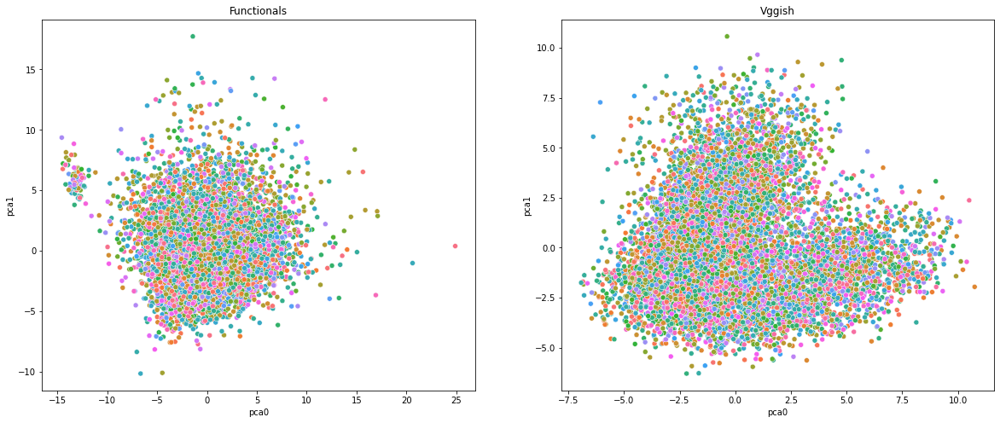

In [8]:
fig, axs = plt.subplots(1, 2, figsize=(20, 8))
sns.scatterplot(ax=axs[0], data=functionals_df, x="pca0", y="pca1", hue="file", legend=False)
sns.scatterplot(ax=axs[1], data=vggish_df, x="pca0", y="pca1", hue="file", legend=False)
axs[0].set_title("Functionals")
axs[1].set_title("Vggish")
plt.show()

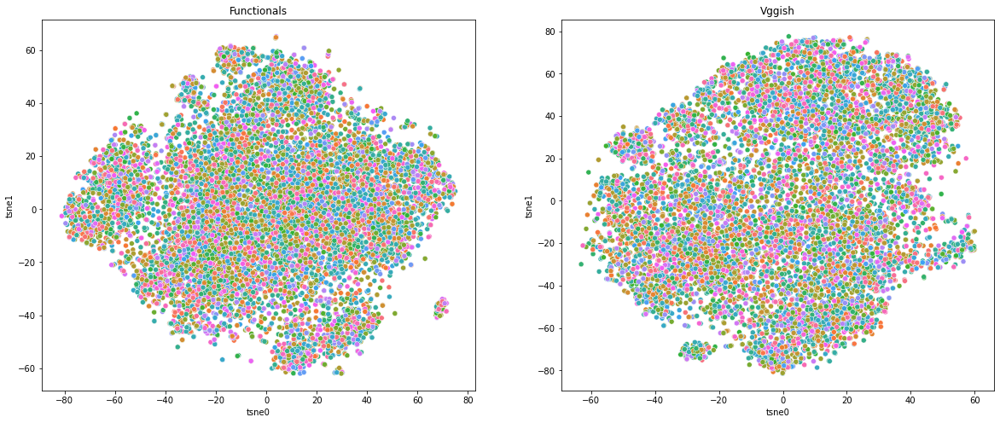

In [9]:
fig, axs = plt.subplots(1, 2, figsize=(20, 8))
sns.scatterplot(ax=axs[0], data=functionals_df, x="tsne0", y="tsne1", hue="file", legend=False)
sns.scatterplot(ax=axs[1], data=vggish_df, x="tsne0", y="tsne1", hue="file", legend=False)
axs[0].set_title("Functionals")
axs[1].set_title("Vggish")
plt.show()

## Functionals k-means Clusters

- 0 (482)  = Talking and music, mix of sexes, musical like voices and upbeat
- 1 (1045) = Talking, mix of sexes, not very clear muffled and distant voices
- 2 (80)   = Silence or odd sound
- 3 (1970) = Talking and laughter, mix of sexes, excitable tone
- 4 (1880) = Talking, mix of sexes, more individual sounds
- 5 (1939) = Talking and sounds, mix of sexes, some musical bits
- 6 (1820) = Talking, mix of sexes, 
- 7 (782)  = Talking and laughter, mix of sexes, some odd sounds
- 8 (1)    = N/A
- 9 (1)    = N/A

In [10]:
y, sr = combine_audio(functionals_df[functionals_df["kmeans_label"] == 0].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [11]:
y, sr = combine_audio(functionals_df[functionals_df["kmeans_label"] == 1].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [12]:
y, sr = combine_audio(functionals_df[functionals_df["kmeans_label"] == 2].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [13]:
y, sr = combine_audio(functionals_df[functionals_df["kmeans_label"] == 3].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [14]:
y, sr = combine_audio(functionals_df[functionals_df["kmeans_label"] == 4].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [15]:
y, sr = combine_audio(functionals_df[functionals_df["kmeans_label"] == 5].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [16]:
y, sr = combine_audio(functionals_df[functionals_df["kmeans_label"] == 6].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [17]:
y, sr = combine_audio(functionals_df[functionals_df["kmeans_label"] == 7].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [18]:
y, sr = combine_audio(functionals_df[functionals_df["kmeans_label"] == 8].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [19]:
y, sr = combine_audio(functionals_df[functionals_df["kmeans_label"] == 9].reset_index())
IPython.display.Audio(data=y, rate=sr)

## VGGish k-means Clusters (much more even distribution of clusters)

- 0 (1110) = Talking, mainly male, extended sounds
- 1 (1054) = Talking, mainly female, similar to 6
- 2 (468)  = Talking and music, mix of sexes, music like voices
- 3 (1002) = Talking, mainly male,
- 4 (793)  = Talking, mix of sexes, some excitable sounds
- 5 (1022) = Talking, mainly male, some wierd sounds
- 6 (787)  = Talking, mainly female, similar to 1
- 7 (1073) = Talking, mix of sexes, more individual words/sounds
- 8 (890)  = Talking, mix of sexes, phone in and odd sounds
- 9 (1801) = Talking and wierd sounds, mix of sexes, some musical components

In [20]:
y, sr = combine_audio(vggish_df[vggish_df["kmeans_label"] == 0].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [21]:
y, sr = combine_audio(vggish_df[vggish_df["kmeans_label"] == 1].reset_index())
IPython.display.Audio(data=y, rate=sr)

/unix/cdtdisspotify/env/envs/podcasts/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [22]:
y, sr = combine_audio(vggish_df[vggish_df["kmeans_label"] == 2].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [23]:
y, sr = combine_audio(vggish_df[vggish_df["kmeans_label"] == 3].reset_index())
IPython.display.Audio(data=y, rate=sr)

/unix/cdtdisspotify/env/envs/podcasts/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [24]:
y, sr = combine_audio(vggish_df[vggish_df["kmeans_label"] == 4].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [25]:
y, sr = combine_audio(vggish_df[vggish_df["kmeans_label"] == 5].reset_index())
IPython.display.Audio(data=y, rate=sr)

/unix/cdtdisspotify/env/envs/podcasts/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [26]:
y, sr = combine_audio(vggish_df[vggish_df["kmeans_label"] == 6].reset_index())
IPython.display.Audio(data=y, rate=sr)

/unix/cdtdisspotify/env/envs/podcasts/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [27]:
y, sr = combine_audio(vggish_df[vggish_df["kmeans_label"] == 7].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [28]:
y, sr = combine_audio(vggish_df[vggish_df["kmeans_label"] == 8].reset_index())
IPython.display.Audio(data=y, rate=sr)

In [29]:
y, sr = combine_audio(vggish_df[vggish_df["kmeans_label"] == 9].reset_index())
IPython.display.Audio(data=y, rate=sr)

# Conclusions

- Don't know if 1 second long segments are best for our work, as you are more likely to cluster on framing features.
- VGGish seems to cluster much more based on speaker sex.
- The VGGish clusters are much more even in size.
- Maybe it is slightly easier to pick out things from the functionals clusters.
- Much less variation here than in the 100 previous podcasts, this may be because these are the selected ones, could mean that our ability to classify things will differ quite considerably depending on the subset of podcasts we consider.